In [59]:
import pandas as pd
from utils import pubchem_request, pubchem_request_synonym
from tqdm import tqdm
import numpy as np
from joblib import Parallel, delayed

In [36]:
# Load data. Text file of liquid electrolytes' name.
with open('/home/yj/PycharmProjects/MIT/CLaMP/data/liquid_electrolytes.txt', 'r') as f:
    electrolytes = f.readlines()
electrolytes = [elect.split('\n')[0] for elect in electrolytes]

# Get data from pubchem
electrolyte_list = []
for elect in tqdm(electrolytes):
    try:
        item = pubchem_request(elect)[0]
        item['Synonym'] = pubchem_request_synonym(item["IUPACName"])
        electrolyte_list.append(item)
    except: pass
electrolyte_list = pd.DataFrame(electrolyte_list)
electrolyte_list

,CID,CanonicalSMILES,InChI,IUPACName,Synonym,len_synonym
0,81161,C[Si](C)(C)OC1=CCCCC1,"InChI=1S/C9H18OSi/c1-11(2,3)10-9-7-5-4-6-8-9/h...",cyclohexen-1-yloxy(trimethyl)silane,"[6651-36-1, (cyclohex-1-en-1-yloxy)trimethylsi...",41
1,11258643,CCCCN1C=C[N+](=C1)C.C(F)(F)(F)S(=O)(=O)[N-]S(=...,InChI=1S/C8H15N2.C2F6NO4S2/c1-3-4-5-10-7-6-9(2...,bis(trifluoromethylsulfonyl)azanide;1-butyl-3-...,"[174899-83-3, 1-Butyl-3-methyl-1H-imidazol-3-i...",42
2,87098478,CCN1C=C[N+](=C1)C.[N-](S(=O)(=O)F)S(=O)(=O)F,InChI=1S/C6H11N2.F2NO4S2/c1-3-8-5-4-7(2)6-8;1-...,bis(fluorosulfonyl)azanide;1-ethyl-3-methylimi...,"[235789-75-0, 1-Ethyl-3-methylimidazolium bis(...",13
3,2734160,CCN1C=C[N+](=C1)C.[Cl-],InChI=1S/C6H11N2.ClH/c1-3-8-5-4-7(2)6-8;/h4-6H...,1-ethyl-3-methylimidazol-3-ium;chloride,"[1-Ethyl-3-methylimidazolium chloride, 65039-0...",50
4,16211072,CCN1C=C[N+](=C1)C.[N+](=O)([O-])[O-],InChI=1S/C6H11N2.NO3/c1-3-8-5-4-7(2)6-8;2-1(3)...,1-ethyl-3-methylimidazol-3-ium;nitrate,"[1-Ethyl-3-methylimidazolium nitrate, 143314-1...",24
...,...,...,...,...,...,...
152,13385,C1=COC(=O)O1,InChI=1S/C3H2O3/c4-3-5-1-2-6-3/h1-2H,"1,3-dioxol-2-one","[VINYLENE CARBONATE, 1,3-Dioxol-2-one, 872-36-...",47
153,14809,OO.[Zn],InChI=1S/H2O2.Zn/c1-2;/h1-2H;,hydrogen peroxide;zinc,"[hydrogen peroxide;zinc, 1314-22-3, Zinc perox...",6
154,104671,C(F)(F)(F)S(=O)(=O)[O-].C(F)(F)(F)S(=O)(=O)[O-...,"InChI=1S/2CHF3O3S.Zn/c2*2-1(3,4)8(5,6)7;/h2*(H...",zinc;trifluoromethanesulfonate,"[Zinc trifluoromethanesulfonate, 54010-75-2, Z...",36
155,25178006,C(F)(F)(F)S(=O)(=O)[N-]S(=O)(=O)C(F)(F)F.C(F)(...,"InChI=1S/2C2F6NO4S2.Zn/c2*3-1(4,5)14(10,11)9-1...",zinc;bis(trifluoromethylsulfonyl)azanide,"[168106-25-0, Zinc bis(trifluoromethylsulfonyl...",15


In [35]:
electrolyte_list['len_synonym'] = electrolyte_list['Synonym'].apply(lambda x: len(x))
electrolyte_list.to_json('/home/yj/PycharmProjects/MIT/CLaMP/jsons/liquid_electrolytes_initial_data(synonym,smiles).json')

In [53]:
synonym_smiles_list = pd.read_json('/home/yj/PycharmProjects/MIT/CLaMP/jsons/liquid_electrolytes_initial_data(synonym,smiles).json')
chunks = np.array_split(synonym_smiles_list, 10)

def find_similarmols_synonym_chunk(chunk):
    result = []
    for _, elect in tqdm(chunk.iterrows()):
        # find similar molecules with anchor
        try:
            items = pubchem_request(elect['CanonicalSMILES'], key='smiles', task='fastsimilarity_2d', max_records=1000)
            for item in items:
                try:  # If not found, skip
                    item['Synonym'] = pubchem_request_synonym(item["IUPACName"])
                    result.append(item)
                except: pass
        except: pass
    return result

le_similarity_list = Parallel(n_jobs=10)(delayed(find_similarmols_synonym_chunk)(chunk) for chunk in chunks)
le_similarity_list = pd.DataFrame(sum(le_similarity_list, []))

/home/yj/anaconda3/envs/llamat/lib/python3.9/site-packages/numpy/core/fromnumeric.py:59: FutureWarning: 'DataFrame.swapaxes' is deprecated and will be removed in a future version. Please use 'DataFrame.transpose' instead.
  return bound(*args, **kwds)


1it [01:16, 76.09s/it]]

In [52]:
len(le_similarity_list)

2651

In [ ]:

le_similarity_list['len_synonym'] = le_similarity_list['Synonym'].apply(lambda x: len(x))
le_similarity_list.to_json('/home/yj/PycharmProjects/MIT/CLaMP/jsons/liquid_electrolytes_similarity_initial_data.json')

In [63]:
import requests
from utils import pubchem_request


# response = requests.get('https://pubchem.ncbi.nlm.nih.gov/rest/pug/compound/cid/0/synonyms/JSON')
# response.json()['InformationList']['Information'][0]['Synonym']
pubchem_request(10, key='cid')

[{'CID': 10,
  'CanonicalSMILES': 'C1C(NC2=C(N1)NC(=NC2=O)N)CN(C=O)C3=CC=C(C=C3)C(=O)NC(CCC(=O)O)C(=O)O',
  'InChI': 'InChI=1S/C20H23N7O7/c21-20-25-16-15(18(32)26-20)23-11(7-22-16)8-27(9-28)12-3-1-10(2-4-12)17(31)24-13(19(33)34)5-6-14(29)30/h1-4,9,11,13,23H,5-8H2,(H,24,31)(H,29,30)(H,33,34)(H4,21,22,25,26,32)',
  'IUPACName': '2-[[4-[(2-amino-4-oxo-5,6,7,8-tetrahydro-1H-pteridin-6-yl)methyl-formylamino]benzoyl]amino]pentanedioic acid'}]

In [10]:
# Basic molecules
chunks = np.array_split(list(range(50000)), 20)

def find_basic_mols_chunk(chunk):
    result = []
    for i in tqdm(chunk):
        # find similar molecules with anchor
        try:
            item = pubchem_request(i, key='cid')
            item['Synonym'] = pubchem_request_synonym(item["IUPACName"])
            result.append(item)
        except: pass
    return result

basic_mol_list = Parallel(n_jobs=20)(delayed(find_basic_mols_chunk)(chunk) for chunk in chunks)
basic_mol_list = pd.DataFrame(sum(basic_mol_list, []))

basic_mol_list['len_synonym'] = basic_mol_list['Synonym'].apply(lambda x: len(x))
basic_mol_list.to_json('/home/yj/PycharmProjects/MIT/CLaMP/jsons/liquid_electrolytes_similarity_initial_data.json')

100%|██████████| 2500/2500 [34:05<00:00,  1.22it/s]


KeyError: 'Synonym'

In [ ]:

basic_mol_list['len_synonym'] = basic_mol_list['Synonym'].apply(lambda x: len(x))
basic_mol_list.to_json('/home/yj/PycharmProjects/MIT/CLaMP/jsons/liquid_electrolytes_similarity_initial_data.json')

In [6]:

import json
with open('/home/yj/PycharmProjects/MIT/CLaMP/jsons/liquid_electrolytes_data.json', 'r') as f:
        elect_with_paragraphs = json.load(f)
    
electrolytes = [elect for elect in elect_with_paragraphs]
electrolytes

[{'CID': 11258643,
  'CanonicalSMILES': 'CCCCN1C=C[N+](=C1)C.C(F)(F)(F)S(=O)(=O)[N-]S(=O)(=O)C(F)(F)F',
  'InChI': 'InChI=1S/C8H15N2.C2F6NO4S2/c1-3-4-5-10-7-6-9(2)8-10;3-1(4,5)14(10,11)9-15(12,13)2(6,7)8/h6-8H,3-5H2,1-2H3;/q+1;-1',
  'IUPACName': 'bis(trifluoromethylsulfonyl)azanide;1-butyl-3-methylimidazol-3-ium',
  'paragraphs': [['The primary examples of digital printing of solid-state batteries focus on solid polymer electrolytes and incorporate ionic liquids to increase the inherently low ionic conductivities of the polymers. One of the early solid polymer/ionic liquid electrolyte works, published more than a decade ago, utilized an in-house-built dispenser printer to develop a fully printed solid-state battery. To create the battery, an anode comprising mesocarbon microbeads and polyvinylidene difluoride (MCMB/PVDF) was dispenser printed on a printed copper current collector. This MCMB/PVDF anode served as the substrate onto which the electrolyte, comprising a PVDF polymer, an io

In [5]:
df2 = pd.read_json('/home/yj/PycharmProjects/MIT/CLaMP/jsons/liquid_electrolytes_data.json')
df2

,CID,CanonicalSMILES,InChI,IUPACName,paragraphs,doi,num_papers
0,11258643,CCCCN1C=C[N+](=C1)C.C(F)(F)(F)S(=O)(=O)[N-]S(=...,InChI=1S/C8H15N2.C2F6NO4S2/c1-3-4-5-10-7-6-9(2...,bis(trifluoromethylsulfonyl)azanide;1-butyl-3-...,[[The primary examples of digital printing of ...,"[10.1002/adem.201900737, 10.1021/nl4034818, 10...",169
1,87098478,CCN1C=C[N+](=C1)C.[N-](S(=O)(=O)F)S(=O)(=O)F,InChI=1S/C6H11N2.F2NO4S2/c1-3-8-5-4-7(2)6-8;1-...,bis(fluorosulfonyl)azanide;1-ethyl-3-methylimi...,[[The Intriguing Properties of 1-Ethyl-3-methy...,"[10.1007/s10953-018-0814-0, 10.1038/srep32330,...",6
2,2734160,CCN1C=C[N+](=C1)C.[Cl-],InChI=1S/C6H11N2.ClH/c1-3-8-5-4-7(2)6-8;/h4-6H...,1-ethyl-3-methylimidazol-3-ium;chloride,[[All materials and chemicals were purchased c...,"[10.1039/c9nr03112j, 10.1016/j.jpowsour.2014.1...",33
3,16211072,CCN1C=C[N+](=C1)C.[N+](=O)([O-])[O-],InChI=1S/C6H11N2.NO3/c1-3-8-5-4-7(2)6-8;2-1(3)...,1-ethyl-3-methylimidazol-3-ium;nitrate,[[1-Butyl-3-methylimidazolium chloride. 1-Meth...,"[10.1039/c4ra17268j, 10.1039/c4dt03294b]",2
4,2734254,CCN1C=C[N+](=C1)C.[Al-](Cl)(Cl)(Cl)Cl,InChI=1S/C6H11N2.Al.4ClH/c1-3-8-5-4-7(2)6-8;;;...,1-ethyl-3-methylimidazol-3-ium;tetrachloroalum...,"[[Herein, we evaluate the detailed insertion m...","[10.1149/2.0011607jes, 10.1002/ente.201800269,...",10
...,...,...,...,...,...,...,...
115,272683,C[Si](C)(C)P([Si](C)(C)C)[Si](C)(C)C,"InChI=1S/C9H27PSi3/c1-11(2,3)10(12(4,5)6)13(7,...",tris(trimethylsilyl)phosphane,[[Organic phosphines. Trioctylphosphine (TOP) ...,"[10.1039/d0ee02577a, 10.1021/acs.chemmater.6b0...",5
116,13385,C1=COC(=O)O1,InChI=1S/C3H2O3/c4-3-5-1-2-6-3/h1-2H,"1,3-dioxol-2-one",[[Vinylene carbonate (VC) is an effective elec...,"[10.1002/cphc.200800567, 10.1016/j.electacta.2...",287
117,14809,OO.[Zn],InChI=1S/H2O2.Zn/c1-2;/h1-2H;,hydrogen peroxide;zinc,[[Zinc peroxide (ZnO2) nanoparticles were read...,"[10.1039/c3qi00092c, 10.1021/jp9036028]",2
118,104671,C(F)(F)(F)S(=O)(=O)[O-].C(F)(F)(F)S(=O)(=O)[O-...,"InChI=1S/2CHF3O3S.Zn/c2*2-1(3,4)8(5,6)7;/h2*(H...",zinc;trifluoromethanesulfonate,"[[Zinc trifluoromethanesulfonate (Zn(TfO)2, 98...","[10.1007/s11581-018-2644-x, 10.1016/j.cej.2020...",14


In [70]:
basic_mol_list = pd.read_json('/home/yj/PycharmProjects/MIT/CLaMP/jsons/basic_mol_list.json')
basic_mol_list

,CID,CanonicalSMILES,InChI,IUPACName,Synonym,len_synonym
0,1,CC(=O)OC(CC(=O)[O-])C[N+](C)(C)C,InChI=1S/C9H17NO4/c1-7(11)14-8(5-9(12)13)6-10(...,3-acetyloxy-4-(trimethylazaniumyl)butanoate,"[Acetyl-DL-carnitine, acetylcarnitine, DL-O-Ac...",36
1,3,C1=CC(C(C(=C1)C(=O)O)O)O,InChI=1S/C7H8O4/c8-5-3-1-2-4(6(5)9)7(10)11/h1-...,"5,6-dihydroxycyclohexa-1,3-diene-1-carboxylic ...","[5,6-dihydroxycyclohexa-1,3-diene-1-carboxylic...",9
2,4,CC(CN)O,"InChI=1S/C3H9NO/c1-3(5)2-4/h3,5H,2,4H2,1H3",1-aminopropan-2-ol,"[1-Aminopropan-2-ol, 1-AMINO-2-PROPANOL, 78-96...",112
3,5,C(C(=O)COP(=O)(O)O)N,"InChI=1S/C3H8NO5P/c4-1-3(5)2-9-10(6,7)8/h1-2,4...",(3-amino-2-oxopropyl) dihydrogen phosphate,"[3-Amino-2-oxopropyl phosphate, 3-amino-2-oxop...",11
4,6,C1=CC(=C(C=C1[N+](=O)[O-])[N+](=O)[O-])Cl,InChI=1S/C6H3ClN2O4/c7-5-2-1-4(8(10)11)3-6(5)9...,"1-chloro-2,4-dinitrobenzene","[1-chloro-2,4-dinitrobenzene, 2,4-Dinitrochlor...",95
...,...,...,...,...,...,...
25721,49991,C1=C(C=C(C=C1Cl)Cl)OCCN,InChI=1S/C8H9Cl2NO/c9-6-3-7(10)5-8(4-6)12-2-1-...,"2-(3,5-dichlorophenoxy)ethanamine","[2-(3,5-dichlorophenoxy)ethanamine, 67883-07-2...",13
25722,49992,CC(CC(=O)O)OC1=CC(=CC(=C1)Cl)Cl,InChI=1S/C10H10Cl2O3/c1-6(2-10(13)14)15-9-4-7(...,"3-(3,5-dichlorophenoxy)butanoic acid","[67883-08-3, 3-(3,5-DICHLOROPHENOXY)BUTYRIC AC...",5
25723,49993,CCC=CCCOC(=O)C(=CC)C,InChI=1S/C11H18O2/c1-4-6-7-8-9-13-11(12)10(3)5...,hex-3-enyl 2-methylbut-2-enoate,"[67883-79-8, hex-3-enyl 2-methylbut-2-enoate, ...",6
25724,49996,C1=CC(=C(C=C1Br)C2=CC(=C(C=C2Br)Br)Br)Br,InChI=1S/C12H5Br5/c13-6-1-2-9(14)7(3-6)8-4-11(...,"1,2,4-tribromo-5-(2,5-dibromophenyl)benzene","[67888-96-4, 2,2',4,5,5'-PENTABROMOBIPHENYL, 1...",16


: 

In [1]:
import pandas as pd
df0 = pd.read_parquet('real_basic_mols_with_paragraphs_split_1.parquet')
df0

,CID,CanonicalSMILES,InChI,IUPACName,Synonym,len_synonym,paragraphs,doi,num_papers
0,4,CC(CN)O,"InChI=1S/C3H9NO/c1-3(5)2-4/h3,5H,2,4H2,1H3",1-aminopropan-2-ol,"[1-Aminopropan-2-ol, 1-AMINO-2-PROPANOL, 78-96...",112,"[[All reagents, if not addressed differently, ...","[10.1002/adhm.201500359, 10.1016/j.ces.2004.07...",2
1,6,C1=CC(=C(C=C1[N+](=O)[O-])[N+](=O)[O-])Cl,InChI=1S/C6H3ClN2O4/c7-5-2-1-4(8(10)11)3-6(5)9...,"1-chloro-2,4-dinitrobenzene","[1-chloro-2,4-dinitrobenzene, 2,4-Dinitrochlor...",95,[[We recently demonstrated that a rhodium comp...,"[10.1002/chem.201402157, 10.1016/j.electacta.2...",7
2,11,C(CCl)Cl,InChI=1S/C2H4Cl2/c3-1-2-4/h1-2H2,"1,2-dichloroethane","[1,2-dichloroethane, Ethylene dichloride, 107-...",177,[[Microfluidic chips are of considerable recen...,"[10.1016/j.chroma.2009.11.018, 10.1002/pi.2401...",13
3,13,C1=CC(=C(C=C1Cl)Cl)Cl,InChI=1S/C6H3Cl3/c7-4-1-2-5(8)6(9)3-4/h1-3H,"1,2,4-trichlorobenzene","[1,2,4-trichlorobenzene, 120-82-1, Benzene, 1,...",86,[[HPB is soluble in common organic solvents su...,"[10.1002/smll.201403734, 10.1016/j.jcat.2011.0...",10
4,19,C1=CC(=C(C(=C1)O)O)C(=O)O,InChI=1S/C7H6O4/c8-5-3-1-2-4(6(5)9)7(10)11/h1-...,"2,3-dihydroxybenzoic acid","[2,3-Dihydroxybenzoic acid, 303-38-8, Pyrocate...",82,[[The ligands were prepared by a modified lite...,[10.1002/chem.201402370],1
...,...,...,...,...,...,...,...,...,...
4557,49935,CCCCS(=O)(=O)O,"InChI=1S/C4H10O3S/c1-2-3-4-8(5,6)7/h2-4H2,1H3,...",butane-1-sulfonic acid,"[1-Butanesulfonic acid, butane-1-sulfonic acid...",25,[[Hybrid cross-linked membranes of SPES/TEOS/T...,"[10.1016/j.jpowsour.2012.04.008, 10.1016/j.jpo...",6
4558,49939,CCCCCCCCS(=O)(=O)O,"InChI=1S/C8H18O3S/c1-2-3-4-5-6-7-8-12(9,10)11/...",octane-1-sulfonic acid,"[octane-1-sulfonic acid, 1-Octanesulfonic acid...",28,"[[Generally, superhydrophobic surfaces with se...","[10.1002/smll.200900445, 10.1021/jp100584y, 10...",5
4559,49957,CCCCCCCCCCS(=O)(=O)O,InChI=1S/C10H22O3S/c1-2-3-4-5-6-7-8-9-10-14(11...,decane-1-sulfonic acid,"[DECANE-1-SULFONIC ACID, decylsulfonic acid, 2...",18,[[The preparation approach of MMPCM particles ...,"[10.1016/j.cplett.2009.08.033, 10.1016/j.solid...",4
4560,49970,C1=CC2=NC3=C(N2C=C1)N=C(C=C3)N,InChI=1S/C10H8N4/c11-8-5-4-7-10(13-8)14-6-2-1-...,"1,3,8-triazatricyclo[7.4.0.02,7]trideca-2(7),3...","[Glu-P-2, 67730-10-3, 2-Aminodipyrido[1,2-a:3'...",31,[[Solvents and chemicals were HPLC or analytic...,[10.1016/j.aca.2004.12.077],1


In [12]:
df0 = pd.read_parquet('real_basic_mols_with_paragraphs_split_9.parquet')
from tqdm import tqdm
row_list = []
for i, row in tqdm(df0.iterrows()):
    for pgs, doi in zip(row['paragraphs'], row['doi']):
        for pg in pgs:
            item = row.copy()
            item.loc['paragraphs'] = pg
            item.loc['doi'] = doi
            row_list.append(item)
newdf = pd.DataFrame(row_list)
newdf.to_parquet('real_basic_mols_with_sep_paragraphs_split_9.parquet')

5841it [00:07, 824.90it/s] 


In [34]:
df_cat = []
for i in range(10):
    df = pd.read_parquet(f'basic_mols_with_paragraphs_split_{i}.parquet')
    df_cat.append(df)
df_cat = pd.concat(df_cat)
df_cat

,CID,CanonicalSMILES,InChI,IUPACName,Synonym,len_synonym,paragraphs,doi,num_papers
0,12040509,CCCCCCCCCCN1C=C[N+](=C1)C.C(F)(F)(F)S(=O)(=O)[...,InChI=1S/C14H27N2.C2F6NO4S2/c1-3-4-5-6-7-8-9-1...,bis(trifluoromethylsulfonyl)azanide;1-decyl-3-...,"[433337-23-6, 1-Decyl-3-methylimidazolium bis(...",23,[[All chemicals and reagents used in this stud...,"[10.1039/c4dt02766c, 10.1016/j.electacta.2018....",6
1,2758874,CCN1C=C[N+](=C1)C.C(F)(F)(F)S(=O)(=O)[O-],InChI=1S/C6H11N2.CHF3O3S/c1-3-8-5-4-7(2)6-8;2-...,1-ethyl-3-methylimidazol-3-ium;trifluoromethan...,"[145022-44-2, 1-Ethyl-3-methylimidazolium trif...",36,[[1-Ethyl-3-methylimidazolium trifluoromethane...,[10.1016/j.jpowsour.2008.10.112],1
2,2734246,CCCCN1C=C[N+](=C1)C.C(F)(F)(F)S(=O)(=O)[O-],InChI=1S/C8H15N2.CHF3O3S/c1-3-4-5-10-7-6-9(2)8...,1-butyl-3-methylimidazol-3-ium;trifluoromethan...,"[174899-66-2, 1-Butyl-3-methylimidazolium trif...",34,"[[Choline chloride (ChCl, 98%) and iron(III) c...","[10.1039/d0cp01431a, 10.1021/cm9021497, 10.102...",5
3,53316407,CCCCCCCCCCCCN1C=C[N+](=C1)C.C(F)(F)(F)S(=O)(=O...,InChI=1S/C16H31N2.C2F6NO4S2/c1-3-4-5-6-7-8-9-1...,bis(trifluoromethylsulfonyl)azanide;1-dodecyl-...,"[404001-48-5, 1-Dodecyl-3-methylimidazolium bi...",28,[[This work is focused on applying structural ...,"[10.1016/j.electacta.2018.08.055, 10.1016/j.je...",5
4,21932259,CCN1C=C[N+](=C1C)C.C(F)(F)(F)S(=O)(=O)[N-]S(=O...,InChI=1S/C7H13N2.C2F6NO4S2/c1-4-9-6-5-8(3)7(9)...,"bis(trifluoromethylsulfonyl)azanide;1-ethyl-2,...","[174899-90-2, 1-Ethyl-2,3-dimethylimidazolium ...",24,[[This work is focused on applying structural ...,"[10.1016/j.electacta.2018.08.055, 10.1016/j.je...",5
...,...,...,...,...,...,...,...,...,...
526,11851070,C(F)(F)(F)S(=O)(=O)[N-]S(=O)(=O)C(F)(F)F.C(F)(...,"InChI=1S/2C2F6NO4S2.Mg/c2*3-1(4,5)14(10,11)9-1...",magnesium;bis(trifluoromethylsulfonyl)azanide,[magnesium;bis(trifluoromethylsulfonyl)azanide...,6,[[A fair number of different methods exist for...,[10.1002/anie.200906407],1
527,44254269,C(F)(F)(F)S(=O)(=O)[N-]S(=O)(=O)C(F)(F)F.C(F)(...,"InChI=1S/3C2F6NO4S2.La/c3*3-1(4,5)14(10,11)9-1...",bis(trifluoromethylsulfonyl)azanide;lanthanum(3+),[Lanthanum(III) Bis(trifluoromethanesulfonyl)i...,7,"[[Anderson DL, Anderson OL (1970) The bulk mod...","[10.1007/s00269-010-0378-z, 10.1007/s00269-016...",2
528,11135646,C(F)(F)(F)S(=O)(=O)[N-]S(=O)(=O)C(F)(F)F.C(F)(...,"InChI=1S/2C2F6NO4S2.Mg/c2*3-1(4,5)14(10,11)9-1...",magnesium;bis(trifluoromethylsulfonyl)azanide,[magnesium;bis(trifluoromethylsulfonyl)azanide...,6,[[A fair number of different methods exist for...,[10.1002/anie.200906407],1
529,87673939,C(F)(F)(F)S(=O)(=O)NS(=O)(=O)C(F)(F)F.C(F)(F)(...,"InChI=1S/2C2HF6NO4S2/c2*3-1(4,5)14(10,11)9-15(...","1,1,1-trifluoro-N-(trifluoromethylsulfonyl)met...","[82113-65-3, 1,1,1-Trifluoro-N-((trifluorometh...",53,[[Activity is the measure of the effective con...,"[10.1021/acs.iecr.5b04152, 10.1039/d1tc03004c,...",22


In [35]:
df_cat[['CanonicalSMILES', 'Synonym', 'len_synonym', 'paragraphs', 'doi', 'num_papers']]

,CanonicalSMILES,Synonym,len_synonym,paragraphs,doi,num_papers
0,CCCCCCCCCCN1C=C[N+](=C1)C.C(F)(F)(F)S(=O)(=O)[...,"[433337-23-6, 1-Decyl-3-methylimidazolium bis(...",23,[[All chemicals and reagents used in this stud...,"[10.1039/c4dt02766c, 10.1016/j.electacta.2018....",6
1,CCN1C=C[N+](=C1)C.C(F)(F)(F)S(=O)(=O)[O-],"[145022-44-2, 1-Ethyl-3-methylimidazolium trif...",36,[[1-Ethyl-3-methylimidazolium trifluoromethane...,[10.1016/j.jpowsour.2008.10.112],1
2,CCCCN1C=C[N+](=C1)C.C(F)(F)(F)S(=O)(=O)[O-],"[174899-66-2, 1-Butyl-3-methylimidazolium trif...",34,"[[Choline chloride (ChCl, 98%) and iron(III) c...","[10.1039/d0cp01431a, 10.1021/cm9021497, 10.102...",5
3,CCCCCCCCCCCCN1C=C[N+](=C1)C.C(F)(F)(F)S(=O)(=O...,"[404001-48-5, 1-Dodecyl-3-methylimidazolium bi...",28,[[This work is focused on applying structural ...,"[10.1016/j.electacta.2018.08.055, 10.1016/j.je...",5
4,CCN1C=C[N+](=C1C)C.C(F)(F)(F)S(=O)(=O)[N-]S(=O...,"[174899-90-2, 1-Ethyl-2,3-dimethylimidazolium ...",24,[[This work is focused on applying structural ...,"[10.1016/j.electacta.2018.08.055, 10.1016/j.je...",5
...,...,...,...,...,...,...
526,C(F)(F)(F)S(=O)(=O)[N-]S(=O)(=O)C(F)(F)F.C(F)(...,[magnesium;bis(trifluoromethylsulfonyl)azanide...,6,[[A fair number of different methods exist for...,[10.1002/anie.200906407],1
527,C(F)(F)(F)S(=O)(=O)[N-]S(=O)(=O)C(F)(F)F.C(F)(...,[Lanthanum(III) Bis(trifluoromethanesulfonyl)i...,7,"[[Anderson DL, Anderson OL (1970) The bulk mod...","[10.1007/s00269-010-0378-z, 10.1007/s00269-016...",2
528,C(F)(F)(F)S(=O)(=O)[N-]S(=O)(=O)C(F)(F)F.C(F)(...,[magnesium;bis(trifluoromethylsulfonyl)azanide...,6,[[A fair number of different methods exist for...,[10.1002/anie.200906407],1
529,C(F)(F)(F)S(=O)(=O)NS(=O)(=O)C(F)(F)F.C(F)(F)(...,"[82113-65-3, 1,1,1-Trifluoro-N-((trifluorometh...",53,[[Activity is the measure of the effective con...,"[10.1021/acs.iecr.5b04152, 10.1039/d1tc03004c,...",22


In [45]:
pd.read_parquet(f'/home/yj/PycharmProjects/MIT/CLaMP/data/similar_mols_with_paragraphs_{"val"}.parquet')

,CID,CanonicalSMILES,InChI,IUPACName,Synonym,len_synonym,paragraphs,doi,num_papers
0,7765,CCOC(C)OCC,"InChI=1S/C6H14O2/c1-4-7-6(3)8-5-2/h6H,4-5H2,1-3H3","1,1-diethoxyethane","[Acetal, 1,1-DIETHOXYETHANE, 105-57-7, Acetald...",119,"Nowadays, more than 600 disinfection by-produc...",10.1016/j.chroma.2011.09.048,11
1,12040509,CCCCCCCCCCN1C=C[N+](=C1)C.C(F)(F)(F)S(=O)(=O)[...,InChI=1S/C14H27N2.C2F6NO4S2/c1-3-4-5-6-7-8-9-1...,bis(trifluoromethylsulfonyl)azanide;1-decyl-3-...,"[433337-23-6, 1-Decyl-3-methylimidazolium bis(...",23,Quasielastic neutron scattering (QENS) has bee...,10.1021/jp3070344,10
2,11459786,CCCN1C=C[N+](=C1C)C.[I-],InChI=1S/C8H15N2.HI/c1-4-5-10-7-6-9(3)8(10)2;/...,"1,2-dimethyl-3-propylimidazol-1-ium;iodide","[218151-78-1, 1,2-Dimethyl-3-propyl-1H-imidazo...",27,The counter electrode of platinum was coated o...,10.1021/jp106275v,20
3,5150536,C1=CC=[C+]C=C1,InChI=1S/C6H5/c1-2-4-6-5-3-1/h1-5H/q+1,cyclohexatriene,"[benzene, benzol, 71-43-2, Cyclohexatriene, be...",169,Four different pipes with unknown polyethylene...,10.1016/j.polymertesting.2009.06.004,40
4,87673939,C(F)(F)(F)S(=O)(=O)NS(=O)(=O)C(F)(F)F.C(F)(F)(...,"InChI=1S/2C2HF6NO4S2/c2*3-1(4,5)14(10,11)9-15(...","1,1,1-trifluoro-N-(trifluoromethylsulfonyl)met...","[82113-65-3, 1,1,1-Trifluoro-N-((trifluorometh...",53,"API (98%), PDMA (>95%), and p-dichloroxylene (...",10.1021/acs.iecr.7b00462,37
...,...,...,...,...,...,...,...,...,...
3812,91666461,[CH2-]COCCOCCO[CH2+],InChI=1S/C7H14O3/c1-3-9-6-7-10-5-4-8-2/h1-7H2,1-(2-ethoxyethoxy)-2-methoxyethane,"[1-ETHOXY-2-(2-METHOXYETHOXY)ETHANE, 1002-67-1...",32,[FAC-(ME2PCH2PPH2)3RE](B(C6F5)4)2 (11),10.1021/acs.inorgchem.5b01395,10
3813,6344,C(Cl)Cl,InChI=1S/CH2Cl2/c2-1-3/h1H2,dichloromethane,"[DICHLOROMETHANE, Methylene chloride, 75-09-2,...",206,GAS CHROMATOGRAPHY-MASS SPECTROMETRY (GC–MS) A...,10.1038/s41598-021-85790-6,18
3814,10892,C1=CC(=CC=C1F)F,InChI=1S/C6H4F2/c7-5-1-2-6(8)4-3-5/h1-4H,"1,4-difluorobenzene","[1,4-DIFLUOROBENZENE, 540-36-3, p-Difluorobenz...",39,Solar energy is the best choice among renewabl...,10.1021/acsami.7b05787,4
3815,2758875,C(F)(F)(F)S(=O)(=O)[O-],"InChI=1S/CHF3O3S/c2-1(3,4)8(5,6)7/h(H,5,6,7)/p-1",trifluoromethanesulfonate,"[trifluoromethanesulfonate, triflate, Triflat,...",16,The application of heterogeneous catalysts in ...,10.1039/d0ra04008h,43


In [49]:
df = pd.concat([pd.read_parquet(f'/home/yj/PycharmProjects/MIT/CLaMP/data/similar_mols_with_paragraphs_{split}.parquet') for split in ['train', 'val', 'test']])

In [51]:
df[['CanonicalSMILES', 'Synonym', 'len_synonym', 'paragraphs', 'doi', 'num_papers']]

,CanonicalSMILES,Synonym,len_synonym,paragraphs,doi,num_papers
0,CCOC(=O)C,"[ETHYL ACETATE, 141-78-6, Ethyl ethanoate, Ace...",181,1-CHLORO-2-PENTAFLUOROSULFANYLETHYL ACETATE (11),10.1016/j.jfluchem.2006.05.003,11
1,CCOC(=O)C,"[ETHYL ACETATE, 141-78-6, Ethyl ethanoate, Ace...",181,RECYCLE EXPERIMENTS FOR THE FORMATION OF ETHYL...,10.1002/app.38045,10
2,[I-].[I-].[I-],"[Iodide, Iodide ion, 20461-54-5, Iodide anion,...",42,Iodide/triiodide ( I-/I3- ) redox electrolyte ...,10.1016/j.solmat.2016.07.023,42
3,CCCCOC(=O)C,"[Butyl acetate, N-BUTYL ACETATE, 123-86-4, Ace...",115,The synthesis route of POSS-based fluorinated ...,10.1007/s10853-018-2730-5,10
4,CC(=C)C=C,"[ISOPRENE, 78-79-5, 2-Methyl-1,3-butadiene, 2-...",124,SYNTHESIS OF POLY(STYRENE-B-SULFONATED ISOPREN...,10.1016/j.memsci.2015.02.038,14
...,...,...,...,...,...,...
4408,Cl[Ti](Cl)(Cl)Cl,"[TITANIUM TETRACHLORIDE, Tetrachlorotitanium, ...",52,It was hypothesized that BCPs containing poly(...,10.1016/j.polymer.2004.05.003,10
4409,CO[CH-]OC,"[Dimethoxymethane, METHYLAL, 109-87-5, Formal,...",53,"Hui Xu: Methodology, Software, Formal analysis...",10.1016/j.conbuildmat.2020.118225,15
4410,CN(C)C=O,"[N,N-DIMETHYLFORMAMIDE, Dimethylformamide, 68-...",210,One of the major objectives to obtain SPWLE co...,10.1021/acs.chemrev.8b00222,50
4411,C1=CC(=C(C=C1C(=O)N)F)F,"[3,4-Difluorobenzamide, 85118-04-3, MFCD000155...",30,By increasing the metamorphic temperature at t...,10.1016/j.jafrearsci.2016.11.013,10


In [53]:
pd.read_parquet('/home/yj/PycharmProjects/MIT/CLaMP/data/real_basic_mols_with_sep_paragraphs.parquet')[['CanonicalSMILES', 'Synonym', 'len_synonym', 'paragraphs', 'doi', 'num_papers']]

,CanonicalSMILES,Synonym,len_synonym,paragraphs,doi,num_papers
0,CC(CN)O,"[1-Aminopropan-2-ol, 1-AMINO-2-PROPANOL, 78-96...",112,Transient experiments were also run over extru...,10.1016/j.cattod.2005.06.043,1
1,C1=CC(=C(C=C1[N+](=O)[O-])[N+](=O)[O-])Cl,"[1-chloro-2,4-dinitrobenzene, 2,4-Dinitrochlor...",95,Polymer membranes of polyethylene terephthalat...,10.1016/j.snb.2016.09.061,1
2,C1(C(C(C(C(C1O)O)OP(=O)(O)O)O)O)O,"[573-35-3, (2,3,4,5,6-pentahydroxycyclohexyl) ...",13,The binding of the most common metal cations o...,10.1021/jp068890d,1
3,C(CCl)Cl,"[1,2-dichloroethane, Ethylene dichloride, 107-...",177,The Fenton reaction was studied voltammetrical...,10.1016/j.jelechem.2003.09.021,12
3,C(CCl)Cl,"[1,2-dichloroethane, Ethylene dichloride, 107-...",177,The ferrocene derivative used as a reactant in...,10.1016/j.jelechem.2003.09.021,12
...,...,...,...,...,...,...
5839,CCCCCCCCS(=O)(=O)O,"[octane-1-sulfonic acid, 1-Octanesulfonic acid...",28,Our procedures for microdialysis have previous...,10.1038/npp.2010.69,14
5839,CCCCCCCCS(=O)(=O)O,"[octane-1-sulfonic acid, 1-Octanesulfonic acid...",28,"Perfluoroalkyl acids (PFAAs), including perflu...",10.1016/j.jhazmat.2020.122617,14
5839,CCCCCCCCS(=O)(=O)O,"[octane-1-sulfonic acid, 1-Octanesulfonic acid...",28,"We measured the levels of 5-HT, 5-HIAA, NE, an...",10.1038/s41598-018-19433-8,14
5839,CCCCCCCCS(=O)(=O)O,"[octane-1-sulfonic acid, 1-Octanesulfonic acid...",28,Measurements of DA and 5HTmetabolites in colle...,10.1038/s41598-017-18130-2,14


In [64]:
Chem.MolFromSmiles('C[Si](C)(C)OC1=CCCCC1')
pubchem_request('C[Si](C)(C)OC1=CCCCC1', key='smiles', task='fastsimilarity_2d', max_records=10)

[{'CID': 81161,
  'CanonicalSMILES': 'C[Si](C)(C)OC1=CCCCC1',
  'InChI': 'InChI=1S/C9H18OSi/c1-11(2,3)10-9-7-5-4-6-8-9/h7H,4-6,8H2,1-3H3',
  'IUPACName': 'cyclohexen-1-yloxy(trimethyl)silane'},
 {'CID': 11789903,
  'CanonicalSMILES': 'C[Si](C)(C)OC1=CCCCCC1',
  'InChI': 'InChI=1S/C10H20OSi/c1-12(2,3)11-10-8-6-4-5-7-9-10/h8H,4-7,9H2,1-3H3',
  'IUPACName': 'cyclohepten-1-yloxy(trimethyl)silane'},
 {'CID': 11063095,
  'CanonicalSMILES': 'CC1CCCC=C1O[Si](C)(C)C',
  'InChI': 'InChI=1S/C10H20OSi/c1-9-7-5-6-8-10(9)11-12(2,3)4/h8-9H,5-7H2,1-4H3',
  'IUPACName': 'trimethyl-(6-methylcyclohexen-1-yl)oxysilane'},
 {'CID': 11043308,
  'CanonicalSMILES': 'CC(C)[Si](C(C)C)(C(C)C)OC1=CCCCC1',
  'InChI': 'InChI=1S/C15H30OSi/c1-12(2)17(13(3)4,14(5)6)16-15-10-8-7-9-11-15/h10,12-14H,7-9,11H2,1-6H3',
  'IUPACName': 'cyclohexen-1-yloxy-tri(propan-2-yl)silane'},
 {'CID': 11020218,
  'CanonicalSMILES': 'CC[Si](CC)(CC)OC1=CCCCC1',
  'InChI': 'InChI=1S/C12H24OSi/c1-4-14(5-2,6-3)13-12-10-8-7-9-11-12/h10H,4-9,11H

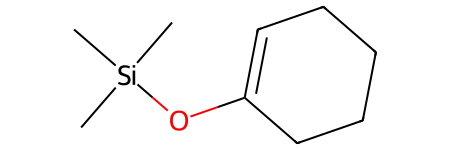

In [62]:
Chem.MolFromSmiles('C[Si](C)(C)OC1=CCCCC1')


In [68]:
import requests
chemical_name = 'trimethyl-(6-methylcyclohexen-1-yl)oxysilane'
response = requests.get(f'https://pubchem.ncbi.nlm.nih.gov/rest/pug/compound/name/{chemical_name}/synonyms/JSON')
response.json()['InformationList']['Information'][0]['Synonym']

KeyError: 'InformationList'

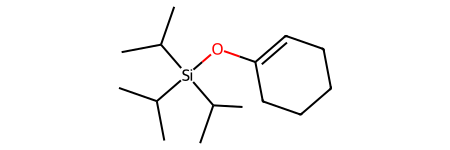

In [69]:
from rdkit import Chem
Chem.MolFromSmiles('CC(C)[Si](C(C)C)(C(C)C)OC1=CCCCC1')

In [39]:
# CID deduplication
df_cat.drop_duplicates(subset=['CID'])[['CanonicalSMILES', 'Synonym', 'len_synonym', 'paragraphs', 'doi', 'num_papers']]


,CanonicalSMILES,Synonym,len_synonym,paragraphs,doi,num_papers
0,CCCCCCCCCCN1C=C[N+](=C1)C.C(F)(F)(F)S(=O)(=O)[...,"[433337-23-6, 1-Decyl-3-methylimidazolium bis(...",23,[[All chemicals and reagents used in this stud...,"[10.1039/c4dt02766c, 10.1016/j.electacta.2018....",6
1,CCN1C=C[N+](=C1)C.C(F)(F)(F)S(=O)(=O)[O-],"[145022-44-2, 1-Ethyl-3-methylimidazolium trif...",36,[[1-Ethyl-3-methylimidazolium trifluoromethane...,[10.1016/j.jpowsour.2008.10.112],1
2,CCCCN1C=C[N+](=C1)C.C(F)(F)(F)S(=O)(=O)[O-],"[174899-66-2, 1-Butyl-3-methylimidazolium trif...",34,"[[Choline chloride (ChCl, 98%) and iron(III) c...","[10.1039/d0cp01431a, 10.1021/cm9021497, 10.102...",5
3,CCCCCCCCCCCCN1C=C[N+](=C1)C.C(F)(F)(F)S(=O)(=O...,"[404001-48-5, 1-Dodecyl-3-methylimidazolium bi...",28,[[This work is focused on applying structural ...,"[10.1016/j.electacta.2018.08.055, 10.1016/j.je...",5
4,CCN1C=C[N+](=C1C)C.C(F)(F)(F)S(=O)(=O)[N-]S(=O...,"[174899-90-2, 1-Ethyl-2,3-dimethylimidazolium ...",24,[[This work is focused on applying structural ...,"[10.1016/j.electacta.2018.08.055, 10.1016/j.je...",5
...,...,...,...,...,...,...
457,C=CC=CC1=CC=CC=C1,"[16939-57-4, 1-Phenyl-1,3-butadiene, (E)-Buta-...",32,[[Pd and Ni complexes of the chiral diphosphin...,[10.1039/c0cc01452d],1
459,CCC#CC1=CC=CC=C1,"[1-Phenyl-1-butyne, 622-76-4, 1-Butynylbenzene...",29,"[[As mentioned above, the hydration of termina...",[10.1039/c5cc00120j],1
470,CC1=CC=CC=C1C,"[1,2-bis(trideuteriomethyl)benzene, 25319-54-4...",8,[[Guillomot M: Cellular interactions during im...,[10.1186/2049-1891-3-23],1
478,C1CC1=CC2=CC=CC=C2,"[Benzene, (cyclopropylidenemethyl)-, (Cyclopro...",15,[[Allylidenecyclopropanes exhibit a good react...,[10.1021/cr010005u],1


In [14]:
df_cat.to_parquet('real_basic_mols_with_sep_paragraphs.parquet')

In [15]:
train_df = []
val_df = []
test_df = []
for cid in df_cat['CID'].unique():
    # split 8:1:1 for train/val/test
    cid_temp = df_cat[df_cat['CID'] == cid]
    train_df.append(cid_temp.iloc[:int(len(cid_temp)*0.9)])
    val_df.append(cid_temp.iloc[int(len(cid_temp)*0.9):int(len(cid_temp)*0.95)])
    test_df.append(cid_temp.iloc[int(len(cid_temp)*0.95):])
train_df = pd.concat(train_df)
val_df = pd.concat(val_df)
test_df = pd.concat(test_df)
# shuffle each dataframe

train_df = train_df.sample(frac=1).reset_index(drop=True)
val_df = val_df.sample(frac=1).reset_index(drop=True)
test_df = test_df.sample(frac=1).reset_index(drop=True)
print(len(train_df), len(val_df), len(test_df))


487071 26668 33318


In [16]:

train_df.to_parquet('real_basic_mols_with_sep_paragraphs_train.parquet')
val_df.to_parquet('real_basic_mols_with_sep_paragraphs_val.parquet')
test_df.to_parquet('real_basic_mols_with_sep_paragraphs_test.parquet')

In [17]:
for split in ['train', 'val', 'test']:
    df_basic = pd.read_parquet(f'real_basic_mols_with_sep_paragraphs_{split}.parquet')
    df_sim = pd.read_parquet(f'similar_mols_with_paragraphs_{split}.parquet')
    df = pd.concat([df_basic, df_sim])
    df.to_parquet(f'electrolytes_sep_paragraphs_{split}.parquet')

In [ ]:
tokenizer.mask_token_id

In [1]:
import pandas as pd
df_train = pd.read_parquet('electrolytes_sep_paragraphs_val.parquet')
df_train

,CID,CanonicalSMILES,InChI,IUPACName,Synonym,len_synonym,doi,num_papers,node_feat,edge_index,edge_attr,y,text
0,6934,CC1=CC(=C(C=C1)N)S(=O)(=O)O,"InChI=1S/C7H9NO3S/c1-5-2-3-6(8)7(4-5)12(9,10)1...",2-amino-5-methylbenzenesulfonic acid,"[88-44-8, 2-Amino-5-methylbenzenesulfonic acid...",69,10.1021/nn204875a,10,"[[5, 0], [5, 0], [5, 0], [5, 0], [5, 0], [5, 0...","[[0, 1, 1, 2, 2, 3, 3, 4, 4, 5, 5, 6, 4, 7, 3,...","[[0, 0], [0, 0], [3, 0], [3, 0], [3, 0], [3, 0...",[0],A heavily doped silicon substrate with 300 nm ...
2,12232,CSSC,InChI=1S/C2H6S2/c1-3-4-2/h1-2H3,(methyldisulfanyl)methane,"[Dimethyl disulfide, 624-92-0, METHYL DISULFID...",74,10.1016/j.wasman.2008.08.029,16,"[[5, 0], [15, 0], [15, 0], [5, 0], [0, 0], [0,...","[[0, 1, 1, 2, 2, 3, 0, 4, 0, 5, 0, 6, 3, 7, 3,...","[[0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0...",[0],"In Table 5, the experimental results of our in..."
3,12597,C1C(C2C(O1)C(CO2)O)O,InChI=1S/C6H10O4/c7-3-1-9-6-4(8)2-10-5(3)6/h3-...,"(3S,3aR,6R,6aR)-2,3,3a,5,6,6a-hexahydrofuro[3,...","[isosorbide, 652-67-5, Isobide, Devicoran, Hyd...",105,10.1016/j.colsurfa.2017.07.037,11,"[[5, 0], [5, 0], [5, 0], [5, 0], [7, 0], [5, 0...","[[0, 1, 1, 2, 2, 3, 3, 4, 3, 5, 5, 6, 6, 7, 5,...","[[0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0...",[0],It is important to utilize surfactants derived...
4,6031,C1=CN(C(=O)NC1=O)C2C(C(C(O2)COP(=O)(O)OP(=O)(O...,InChI=1S/C9H14N2O12P2/c12-5-1-2-11(9(15)10-5)8...,"[(2R,3S,4R,5R)-5-(2,4-dioxopyrimidin-1-yl)-3,4...","[Uridine 5'-diphosphate, URIDINE DIPHOSPHATE, ...",46,10.1016/j.febslet.2012.03.003,10,"[[5, 0], [5, 0], [6, 0], [5, 0], [7, 0], [6, 0...","[[0, 1, 1, 2, 2, 3, 3, 4, 3, 5, 5, 6, 6, 7, 2,...","[[3, 0], [3, 0], [3, 0], [3, 0], [3, 0], [3, 0...",[0],Kinetic parameters of UGT94E5 for crocetin glu...
5,10113,C(=O)(C(=O)N)N,"InChI=1S/C2H4N2O2/c3-1(5)2(4)6/h(H2,3,5)(H2,4,6)",oxamide,"[OXAMIDE, Ethanediamide, 471-46-5, Oxalamide, ...",44,10.1016/j.ejmech.2016.07.038,11,"[[5, 0], [7, 0], [5, 0], [7, 0], [6, 0], [6, 0...","[[0, 1, 0, 2, 2, 3, 2, 4, 0, 5, 4, 6, 4, 7, 5,...","[[1, 0], [1, 0], [0, 0], [0, 0], [1, 0], [1, 0...",[0],N-(TRANS-4-(2-(4-(BENZO[D]ISOTHIAZOL-3-YL)PIPE...
...,...,...,...,...,...,...,...,...,...,...,...,...,...
3811,12206865,CCOC(=O)C,"InChI=1S/C4H8O2/c1-3-6-4(2)5/h3H2,1-2H3/i4+2",ethyl acetate,"[ETHYL ACETATE, 141-78-6, Ethyl ethanoate, Ace...",181,10.1016/j.catcom.2020.106239,10,"[[5, 0], [5, 0], [7, 0], [5, 0], [7, 0], [5, 0...","[[0, 1, 1, 2, 2, 3, 3, 4, 3, 5, 0, 6, 0, 7, 0,...","[[0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0...",[0],FORMATION OF ETHYL ACETATE
3812,91666461,[CH2-]COCCOCCO[CH2+],InChI=1S/C7H14O3/c1-3-9-6-7-10-5-4-8-2/h1-7H2,1-(2-ethoxyethoxy)-2-methoxyethane,"[1-ETHOXY-2-(2-METHOXYETHOXY)ETHANE, 1002-67-1...",32,10.1021/acs.inorgchem.5b01395,10,"[[5, 0], [5, 0], [7, 0], [5, 0], [5, 0], [7, 0...","[[0, 1, 1, 2, 2, 3, 3, 4, 4, 5, 5, 6, 6, 7, 7,...","[[0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0...",[0],[FAC-(ME2PCH2PPH2)3RE](B(C6F5)4)2 (11)
3813,6344,C(Cl)Cl,InChI=1S/CH2Cl2/c2-1-3/h1H2,dichloromethane,"[DICHLOROMETHANE, Methylene chloride, 75-09-2,...",206,10.1038/s41598-021-85790-6,18,"[[5, 0], [16, 0], [16, 0], [0, 0], [0, 0]]","[[0, 1, 0, 2, 0, 3, 0, 4], [1, 0, 2, 0, 3, 0, ...","[[0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0...",[0],GAS CHROMATOGRAPHY-MASS SPECTROMETRY (GC–MS) A...
3814,10892,C1=CC(=CC=C1F)F,InChI=1S/C6H4F2/c7-5-1-2-6(8)4-3-5/h1-4H,"1,4-difluorobenzene","[1,4-DIFLUOROBENZENE, 540-36-3, p-Difluorobenz...",39,10.1021/acsami.7b05787,4,"[[5, 0], [5, 0], [5, 0], [5, 0], [5, 0], [5, 0...","[[0, 1, 1, 2, 2, 3, 3, 4, 4, 5, 5, 6, 2, 7, 5,...","[[3, 0], [3, 0], [3, 0], [3, 0], [3, 0], [3, 0...",[0],Solar energy is the best choice among renewabl...


In [26]:
point_df = df_train[df_train['CanonicalSMILES'].apply(lambda x: '.' not in x)]

In [16]:
from rdkit import Chem
import torch
import numpy as np
from rdkit.Chem.rdchem import BondType as BT

ATOM_LIST = list(range(1,119))
CHIRALITY_LIST = [
    Chem.rdchem.ChiralType.CHI_UNSPECIFIED,
    Chem.rdchem.ChiralType.CHI_TETRAHEDRAL_CW,
    Chem.rdchem.ChiralType.CHI_TETRAHEDRAL_CCW,
    Chem.rdchem.ChiralType.CHI_OTHER
]
BOND_LIST = [BT.SINGLE, BT.DOUBLE, BT.TRIPLE, BT.AROMATIC]
BONDDIR_LIST = [
    Chem.rdchem.BondDir.NONE,
    Chem.rdchem.BondDir.ENDUPRIGHT,
    Chem.rdchem.BondDir.ENDDOWNRIGHT
]

def smiles_to_graph(smiles):
    mol = Chem.MolFromSmiles(smiles)
    mol = Chem.AddHs(mol)

    N = mol.GetNumAtoms()
    M = mol.GetNumBonds()

    type_idx = []
    chirality_idx = []
    atomic_number = []
    for atom in mol.GetAtoms():
        type_idx.append(ATOM_LIST.index(atom.GetAtomicNum()))
        chirality_idx.append(CHIRALITY_LIST.index(atom.GetChiralTag()))
        atomic_number.append(atom.GetAtomicNum())

    x1 = torch.tensor(type_idx, dtype=torch.long).view(-1,1)
    x2 = torch.tensor(chirality_idx, dtype=torch.long).view(-1,1)
    x = torch.cat([x1, x2], dim=-1)

    row, col, edge_feat = [], [], []
    for bond in mol.GetBonds():
        start, end = bond.GetBeginAtomIdx(), bond.GetEndAtomIdx()
        row += [start, end]
        col += [end, start]
        edge_feat.append([
            BOND_LIST.index(bond.GetBondType()),
            BONDDIR_LIST.index(bond.GetBondDir())
        ])
        edge_feat.append([
            BOND_LIST.index(bond.GetBondType()),
            BONDDIR_LIST.index(bond.GetBondDir())
        ])

    edge_index = torch.tensor([row, col], dtype=torch.long)
    edge_attr = torch.tensor(np.array(edge_feat), dtype=torch.long)

    return x.tolist(), edge_index.tolist(), edge_attr.tolist()

In [27]:
from tqdm import tqdm
results = []
for i, row in tqdm(point_df.iterrows()):
    try:
        x, edge_index, edge_attr = smiles_to_graph(row['CanonicalSMILES'])
        row['node_feat'] = x
        row['edge_index'] = edge_index
        row['edge_attr'] = edge_attr
        row['y'] = [0]
        
        results.append(row)
    except: print(row['CanonicalSMILES'])
results = pd.DataFrame(results)

305it [00:00, 534.88it/s][15:25:03] WARNING: not removing hydrogen atom without neighbors
643it [00:01, 545.42it/s][15:25:03] WARNING: not removing hydrogen atom without neighbors
883it [00:01, 577.06it/s][15:25:04] WARNING: not removing hydrogen atom without neighbors
1496it [00:02, 597.06it/s][15:25:05] WARNING: not removing hydrogen atom without neighbors
1617it [00:02, 597.11it/s][15:25:05] WARNING: not removing hydrogen atom without neighbors
1682it [00:02, 612.15it/s][15:25:05] WARNING: not removing hydrogen atom without neighbors
[15:25:05] Explicit valence for atom # 1 Cl, 3, is greater than permitted
1806it [00:03, 567.91it/s]

FCl(F)F


1864it [00:03, 532.32it/s][15:25:05] WARNING: not removing hydrogen atom without neighbors
2096it [00:03, 549.21it/s][15:25:06] WARNING: not removing hydrogen atom without neighbors
2268it [00:04, 549.75it/s][15:25:06] Explicit valence for atom # 1 Br, 5, is greater than permitted
2393it [00:04, 581.96it/s]

FBr(F)(F)(F)F


2453it [00:04, 586.58it/s][15:25:06] WARNING: not removing hydrogen atom without neighbors
2515it [00:04, 594.22it/s][15:25:06] Explicit valence for atom # 1 Br, 3, is greater than permitted
2637it [00:04, 574.27it/s]

FBr(F)F


2812it [00:04, 557.53it/s][15:25:07] WARNING: not removing hydrogen atom without neighbors
3141it [00:05, 488.38it/s][15:25:08] WARNING: not removing hydrogen atom without neighbors
[15:25:08] Explicit valence for atom # 1 Cl, 3, is greater than permitted
[15:25:08] WARNING: not removing hydrogen atom without neighbors
3252it [00:05, 508.67it/s]

FCl(F)F


3315it [00:05, 541.50it/s][15:25:08] WARNING: not removing hydrogen atom without neighbors
3378it [00:06, 562.90it/s][15:25:08] WARNING: not removing hydrogen atom without neighbors
4054it [00:07, 573.15it/s][15:25:09] WARNING: not removing hydrogen atom without neighbors
4348it [00:07, 571.64it/s][15:25:10] Explicit valence for atom # 1 Br, 3, is greater than permitted
4474it [00:07, 596.65it/s]

FBr(F)F


4595it [00:08, 599.23it/s][15:25:10] Explicit valence for atom # 1 Cl, 3, is greater than permitted
4656it [00:08, 597.41it/s][15:25:10] WARNING: not removing hydrogen atom without neighbors
4716it [00:08, 594.89it/s]

FCl(F)F


4776it [00:08, 582.76it/s][15:25:10] WARNING: not removing hydrogen atom without neighbors
4897it [00:08, 587.29it/s][15:25:11] WARNING: not removing hydrogen atom without neighbors
4959it [00:08, 594.65it/s][15:25:11] Explicit valence for atom # 1 Cl, 3, is greater than permitted
5085it [00:09, 611.62it/s]

FCl(F)F


5208it [00:09, 570.75it/s][15:25:11] WARNING: not removing hydrogen atom without neighbors
5718it [00:10, 597.35it/s][15:25:12] WARNING: not removing hydrogen atom without neighbors
[15:25:12] WARNING: not removing hydrogen atom without neighbors
6218it [00:10, 609.71it/s][15:25:13] WARNING: not removing hydrogen atom without neighbors
6407it [00:11, 617.79it/s][15:25:13] WARNING: not removing hydrogen atom without neighbors
6595it [00:11, 591.14it/s][15:25:13] WARNING: not removing hydrogen atom without neighbors
6659it [00:11, 597.02it/s][15:25:14] WARNING: not removing hydrogen atom without neighbors
6777it [00:11, 530.22it/s][15:25:14] WARNING: not removing hydrogen atom without neighbors
6899it [00:12, 563.51it/s][15:25:14] WARNING: not removing hydrogen atom without neighbors
7199it [00:12, 578.13it/s][15:25:15] WARNING: not removing hydrogen atom without neighbors
7323it [00:12, 596.38it/s][15:25:15] WARNING: not removing hydrogen atom without neighbors
8171it [00:14, 553.48it/s

F[Si-2](F)(F)(F)(F)F


8362it [00:14, 570.17it/s][15:25:17] WARNING: not removing hydrogen atom without neighbors
8742it [00:15, 621.84it/s][15:25:17] WARNING: not removing hydrogen atom without neighbors
8929it [00:15, 583.28it/s][15:25:18] WARNING: not removing hydrogen atom without neighbors
8991it [00:15, 589.06it/s][15:25:18] WARNING: not removing hydrogen atom without neighbors
9051it [00:15, 574.22it/s][15:25:18] WARNING: not removing hydrogen atom without neighbors
9171it [00:16, 559.12it/s][15:25:18] WARNING: not removing hydrogen atom without neighbors
9357it [00:16, 571.65it/s][15:25:18] WARNING: not removing hydrogen atom without neighbors
9859it [00:17, 613.54it/s][15:25:19] WARNING: not removing hydrogen atom without neighbors
10038it [00:17, 554.79it/s][15:25:19] WARNING: not removing hydrogen atom without neighbors
10224it [00:17, 594.57it/s][15:25:20] Explicit valence for atom # 1 Cl, 3, is greater than permitted
10285it [00:17, 598.17it/s]

FCl(F)F


10471it [00:18, 587.69it/s][15:25:20] WARNING: not removing hydrogen atom without neighbors
10595it [00:18, 596.01it/s][15:25:20] WARNING: not removing hydrogen atom without neighbors
10907it [00:19, 610.90it/s][15:25:21] WARNING: not removing hydrogen atom without neighbors
11036it [00:19, 617.76it/s][15:25:21] WARNING: not removing hydrogen atom without neighbors
11098it [00:19, 591.80it/s][15:25:21] WARNING: not removing hydrogen atom without neighbors
11160it [00:19, 599.73it/s][15:25:21] WARNING: not removing hydrogen atom without neighbors
11221it [00:19, 600.74it/s][15:25:21] WARNING: not removing hydrogen atom without neighbors
11282it [00:19, 603.21it/s][15:25:22] WARNING: not removing hydrogen atom without neighbors
11837it [00:20, 587.23it/s][15:25:23] WARNING: not removing hydrogen atom without neighbors
11897it [00:20, 552.22it/s][15:25:23] WARNING: not removing hydrogen atom without neighbors
11956it [00:20, 560.48it/s][15:25:23] WARNING: not removing hydrogen atom withou

FCl(F)F


12647it [00:21, 608.82it/s][15:25:24] WARNING: not removing hydrogen atom without neighbors
13273it [00:23, 583.88it/s][15:25:25] WARNING: not removing hydrogen atom without neighbors
[15:25:25] WARNING: not removing hydrogen atom without neighbors
13827it [00:23, 577.07it/s][15:25:26] WARNING: not removing hydrogen atom without neighbors
14083it [00:24, 623.10it/s][15:25:26] WARNING: not removing hydrogen atom without neighbors
14276it [00:24, 633.19it/s][15:25:27] WARNING: not removing hydrogen atom without neighbors
14469it [00:24, 630.58it/s][15:25:27] WARNING: not removing hydrogen atom without neighbors
14533it [00:25, 623.03it/s][15:25:27] Explicit valence for atom # 1 Cl, 3, is greater than permitted
[15:25:27] WARNING: not removing hydrogen atom without neighbors
14597it [00:25, 627.97it/s][15:25:27] WARNING: not removing hydrogen atom without neighbors
14660it [00:25, 596.88it/s]

FCl(F)F


[15:25:27] WARNING: not removing hydrogen atom without neighbors
14721it [00:25, 595.15it/s][15:25:27] WARNING: not removing hydrogen atom without neighbors
[15:25:27] WARNING: not removing hydrogen atom without neighbors
14909it [00:25, 578.55it/s][15:25:28] WARNING: not removing hydrogen atom without neighbors
15035it [00:25, 601.54it/s][15:25:28] WARNING: not removing hydrogen atom without neighbors
15490it [00:26, 636.58it/s][15:25:29] WARNING: not removing hydrogen atom without neighbors
15871it [00:27, 613.73it/s][15:25:29] WARNING: not removing hydrogen atom without neighbors
[15:25:29] WARNING: not removing hydrogen atom without neighbors
[15:25:29] WARNING: not removing hydrogen atom without neighbors
16327it [00:27, 645.90it/s][15:25:30] WARNING: not removing hydrogen atom without neighbors
[15:25:30] WARNING: not removing hydrogen atom without neighbors
16392it [00:28, 582.89it/s][15:25:30] WARNING: not removing hydrogen atom without neighbors
16584it [00:28, 614.54it/s][15:

FCl(F)F


[15:25:32] WARNING: not removing hydrogen atom without neighbors
17529it [00:30, 626.35it/s][15:25:32] WARNING: not removing hydrogen atom without neighbors
[15:25:32] WARNING: not removing hydrogen atom without neighbors
17594it [00:30, 632.95it/s][15:25:32] WARNING: not removing hydrogen atom without neighbors
17658it [00:30, 627.91it/s][15:25:32] WARNING: not removing hydrogen atom without neighbors
18043it [00:30, 624.92it/s][15:25:33] WARNING: not removing hydrogen atom without neighbors
18235it [00:31, 614.74it/s][15:25:33] WARNING: not removing hydrogen atom without neighbors
18300it [00:31, 624.67it/s][15:25:33] WARNING: not removing hydrogen atom without neighbors
18430it [00:31, 633.78it/s][15:25:33] WARNING: not removing hydrogen atom without neighbors
18495it [00:31, 637.00it/s][15:25:33] WARNING: not removing hydrogen atom without neighbors
[15:25:33] Explicit valence for atom # 1 Cl, 3, is greater than permitted
18559it [00:31, 633.08it/s][15:25:34] WARNING: not removing 

FCl(F)F


18623it [00:31, 596.47it/s][15:25:34] WARNING: not removing hydrogen atom without neighbors
18686it [00:31, 605.68it/s][15:25:34] WARNING: not removing hydrogen atom without neighbors
18816it [00:32, 609.66it/s][15:25:34] WARNING: not removing hydrogen atom without neighbors
[15:25:34] WARNING: not removing hydrogen atom without neighbors
18880it [00:32, 616.26it/s][15:25:34] WARNING: not removing hydrogen atom without neighbors
18945it [00:32, 624.87it/s][15:25:34] WARNING: not removing hydrogen atom without neighbors
[15:25:34] WARNING: not removing hydrogen atom without neighbors
19260it [00:32, 601.40it/s][15:25:35] WARNING: not removing hydrogen atom without neighbors
19324it [00:32, 609.61it/s][15:25:35] WARNING: not removing hydrogen atom without neighbors
[15:25:35] WARNING: not removing hydrogen atom without neighbors
19387it [00:33, 611.96it/s][15:25:35] WARNING: not removing hydrogen atom without neighbors
19709it [00:33, 636.57it/s][15:25:35] WARNING: not removing hydrogen 

FBr(F)F


[15:25:36] WARNING: not removing hydrogen atom without neighbors
[15:25:36] Explicit valence for atom # 1 Br, 3, is greater than permitted
[15:25:36] WARNING: not removing hydrogen atom without neighbors
20413it [00:34, 556.36it/s]

FBr(F)F


20594it [00:35, 583.81it/s][15:25:37] WARNING: not removing hydrogen atom without neighbors
21213it [00:36, 596.12it/s][15:25:38] WARNING: not removing hydrogen atom without neighbors
21400it [00:36, 609.54it/s][15:25:38] WARNING: not removing hydrogen atom without neighbors
21587it [00:36, 587.29it/s][15:25:39] WARNING: not removing hydrogen atom without neighbors
22251it [00:37, 575.06it/s][15:25:40] WARNING: not removing hydrogen atom without neighbors
22369it [00:38, 564.61it/s][15:25:40] WARNING: not removing hydrogen atom without neighbors
22495it [00:38, 594.55it/s][15:25:40] WARNING: not removing hydrogen atom without neighbors
22857it [00:38, 531.86it/s][15:25:41] WARNING: not removing hydrogen atom without neighbors
23229it [00:39, 596.59it/s][15:25:42] WARNING: not removing hydrogen atom without neighbors
23713it [00:40, 538.87it/s][15:25:42] WARNING: not removing hydrogen atom without neighbors
23841it [00:40, 582.30it/s][15:25:43] WARNING: not removing hydrogen atom withou

In [28]:
results.to_parquet('electrolytes_sep_paragraphs_val.parquet')

In [32]:
results = pd.read_parquet('electrolytes_sep_paragraphs_test.parquet')
results['text'] = results['paragraphs'] 
#delete paragraphs
results = results.drop('paragraphs', axis=1)
results.to_parquet('electrolytes_sep_paragraphs_test.parquet')